In [58]:
import pandas  as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats
from mpl_toolkits.mplot3d import axes3d

In [59]:
df =pd.read_csv(r'C:\Users\swaraj\Desktop\codes\rent_estimetoer\experimental.csv')


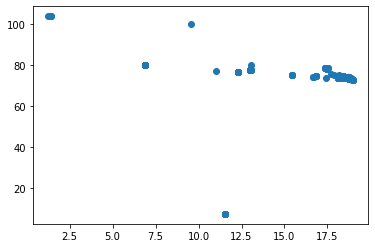

In [60]:
plt.scatter(df.lat,df.longi)

In [61]:
df=df[df['lat']>17]

In [62]:
#tored on github here. Let's load this data stored at geojson format with geopandas, and draw a map with it thanks to geoplot.

# Import the geopandas and geoplot libraries
"""import geopandas as gpd
import geoplot as gplt

# Load the json file with county coordinates
geoData = gpd.read_file('https://raw.githubusercontent.com/holtzy/The-Python-Graph-Gallery/master/static/data/US-counties.geojson')

# Make sure the "id" column is an integer
geoData.id = geoData.id.astype(str).astype(int)

# Remove Alaska, Hawaii and Puerto Rico.
stateToRemove = ['02', '15', '72']
geoData = geoData[~geoData.STATE.isin(stateToRemove)]

# Basic plot with just county outlines
gplt.polyplot(geoData, figsize=(20, 4));"""

'import geopandas as gpd\nimport geoplot as gplt\n\n# Load the json file with county coordinates\ngeoData = gpd.read_file(\'https://raw.githubusercontent.com/holtzy/The-Python-Graph-Gallery/master/static/data/US-counties.geojson\')\n\n# Make sure the "id" column is an integer\ngeoData.id = geoData.id.astype(str).astype(int)\n\n# Remove Alaska, Hawaii and Puerto Rico.\nstateToRemove = [\'02\', \'15\', \'72\']\ngeoData = geoData[~geoData.STATE.isin(stateToRemove)]\n\n# Basic plot with just county outlines\ngplt.polyplot(geoData, figsize=(20, 4));'

In [63]:

import geopandas 
from shapely.geometry import Point, Polygon
import matplotlib.pyplot as plt
gdf = geopandas.GeoDataFrame(df, geometry=geopandas.points_from_xy(df.longi, df.lat))
print(gdf.head())

   Unnamed: 0                           location  Area Sq.ft  bhk  bath_clean  \
0           0                   Saarthi Soverign         950    2           2   
1           1  Maruti Enclave, Tara Dutta Colony         600    2           1   
2           3        Goodwill Unique Zest County         667    2           2   
3           4                        Nikhil Park         735    2           1   
4           5                    Kumar Palmgrove        1200    2           2   

        dates      Title_modify        lat      longi   Rent  \
0  2021-03-17         Mahalunge  18.573820  73.756159  15000   
1  2021-03-17   B.T Kawade Road  18.517725  73.906705  12000   
2  2021-03-17          Lohegaon  18.594470  73.927589  16000   
3  2021-03-17        Manik Baug  18.474525  73.820954  11000   
4  2021-03-17    Kondhwa Budruk  18.450386  73.879375  18000   

                    geometry  
0  POINT (73.75616 18.57382)  
1  POINT (73.90671 18.51772)  
2  POINT (73.92759 18.59447)  
3  P

##
Data filtering 
to remove the outliers on the bases of lat and longi

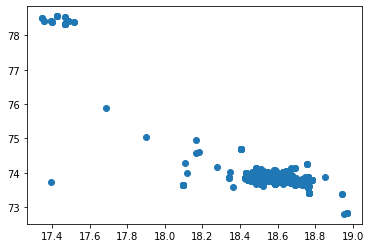

In [66]:
plt.scatter(df.lat,df.longi)

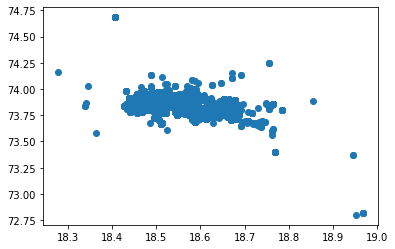

In [67]:
df=df[df['lat']>18.2]
plt.scatter(df.lat,df.longi)

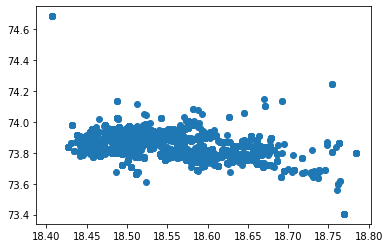

In [68]:
df=df[df['lat']>18.4]
df=df[df['lat']<18.8]
plt.scatter(df.lat,df.longi)

In [69]:
df

,Unnamed: 0,location,Area Sq.ft,bhk,bath_clean,dates,Title_modify,lat,longi,Rent,geometry
0,0,Saarthi Soverign,950,2,2,2021-03-17,Mahalunge,18.573820,73.756159,15000,POINT (73.75616 18.57382)
1,1,"Maruti Enclave, Tara Dutta Colony",600,2,1,2021-03-17,B.T Kawade Road,18.517725,73.906705,12000,POINT (73.90671 18.51772)
2,3,Goodwill Unique Zest County,667,2,2,2021-03-17,Lohegaon,18.594470,73.927589,16000,POINT (73.92759 18.59447)
3,4,Nikhil Park,735,2,1,2021-03-17,Manik Baug,18.474525,73.820954,11000,POINT (73.82095 18.47453)
4,5,Kumar Palmgrove,1200,2,2,2021-03-17,Kondhwa Budruk,18.450386,73.879375,18000,POINT (73.87937 18.45039)
...,...,...,...,...,...,...,...,...,...,...,...
7077,7740,Kohinoor Tinsel Town Phase 2,1011,2,2,2021-03-01,Hinjewadi,18.591272,73.738909,23000,POINT (73.73891 18.59127)
7078,7741,Mayureshwara Heights,650,1,1,2021-03-08,Hingane Home Colony,18.489072,73.810293,10000,POINT (73.81029 18.48907)
7079,7742,Vaishnavi Sahil Heights,583,1,2,2021-02-22,Pimple Nilakh,18.579023,73.785991,14000,POINT (73.78599 18.57902)
7080,7743,SKYi Star Towers,570,2,2,2021-03-09,Bhukum,18.494298,73.722042,12500,POINT (73.72204 18.49430)


In [70]:
pune=(18.516726,73.856255)

In [71]:
new_li=zip(df.lat,df.longi)

In [72]:
len(df.lat)

6942

calculating the distanc efrom the center of the city in this example we ar calculating from railway junction of pune 

In [73]:
from geopy.distance import geodesic

In [74]:
k=[]
for i in new_li:
    k.append((geodesic(i,pune).km))


In [75]:
df['distance_geo_py']= k

In [76]:
df.columns

Index(['Unnamed: 0', 'location', 'Area Sq.ft', 'bhk', 'bath_clean', 'dates',
       'Title_modify', 'lat', 'longi', 'Rent', 'geometry', 'distance_geo_py'],
      dtype='object')

In [77]:
df

,Unnamed: 0,location,Area Sq.ft,bhk,bath_clean,dates,Title_modify,lat,longi,Rent,geometry,distance_geo_py
0,0,Saarthi Soverign,950,2,2,2021-03-17,Mahalunge,18.573820,73.756159,15000,POINT (73.75616 18.57382),12.313004
1,1,"Maruti Enclave, Tara Dutta Colony",600,2,1,2021-03-17,B.T Kawade Road,18.517725,73.906705,12000,POINT (73.90671 18.51772),5.328281
2,3,Goodwill Unique Zest County,667,2,2,2021-03-17,Lohegaon,18.594470,73.927589,16000,POINT (73.92759 18.59447),11.435070
3,4,Nikhil Park,735,2,1,2021-03-17,Manik Baug,18.474525,73.820954,11000,POINT (73.82095 18.47453),5.976328
4,5,Kumar Palmgrove,1200,2,2,2021-03-17,Kondhwa Budruk,18.450386,73.879375,18000,POINT (73.87937 18.45039),7.738232
...,...,...,...,...,...,...,...,...,...,...,...,...
7077,7740,Kohinoor Tinsel Town Phase 2,1011,2,2,2021-03-01,Hinjewadi,18.591272,73.738909,23000,POINT (73.73891 18.59127),14.884507
7078,7741,Mayureshwara Heights,650,1,1,2021-03-08,Hingane Home Colony,18.489072,73.810293,10000,POINT (73.81029 18.48907),5.738218
7079,7742,Vaishnavi Sahil Heights,583,1,2,2021-02-22,Pimple Nilakh,18.579023,73.785991,14000,POINT (73.78599 18.57902),10.127872
7080,7743,SKYi Star Towers,570,2,2,2021-03-09,Bhukum,18.494298,73.722042,12500,POINT (73.72204 18.49430),14.388547


In [78]:
df.to_csv('geodistance.csv')

<ipython-input-79-3c3e91622b4a>:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  dfk=dfk[df['Rent']>i*1000]
<ipython-input-79-3c3e91622b4a>:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  dfk=dfk[df['Rent']>i*1000]
<ipython-input-79-3c3e91622b4a>:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  dfk=dfk[df['Rent']>i*1000]
<ipython-input-79-3c3e91622b4a>:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  dfk=dfk[df['Rent']>i*1000]
<ipython-input-79-3c3e91622b4a>:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  dfk=dfk[df['Rent']>i*1000]
<ipython-input-79-3c3e91622b4a>:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  dfk=dfk[df['Rent']>i*1000]
<ipython-input-79-3c3e91622b4a>:7: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  dfk=dfk[df['Rent']>i*1000]
<ipython-input-79-3c

<AxesSubplot:>

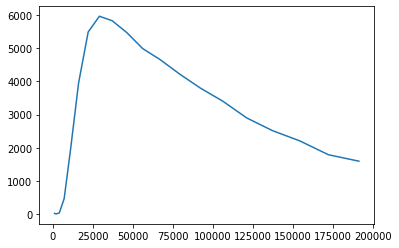

In [79]:
j=1000
l=[]
r=[]
for i in range(0,20):
    j=j+i*1000
    dfk=df[df['Rent']<j]
    dfk=dfk[df['Rent']>i*1000]
    l.append(dfk.shape[0])
    r.append(j)
sns.lineplot(r,l)

In [81]:
df=df[df['distance_geo_py']<20]

In [82]:
df.shape

(6683, 12)

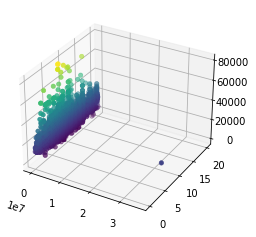

In [84]:

ax = plt.axes(projection='3d')
ax.scatter(df['Area Sq.ft'], df['distance_geo_py'], df['Rent'], c=df['Rent'], linewidth=0.5)


#Plotting on the bases of bhk and distance 

<AxesSubplot:xlabel='distance_geo_py', ylabel='Rent'>

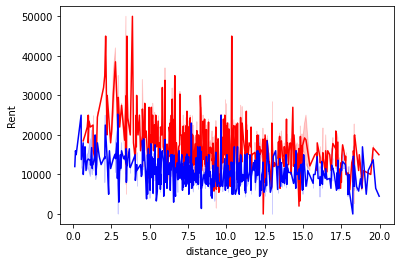

In [87]:
df_bhk=df[df['bhk']==2]
df_bhk=df_bhk[df_bhk['Area Sq.ft']<2000]
sns.lineplot(data=df_bhk, x='distance_geo_py', y="Rent",color='r')
df_bhk=df[df['bhk']==1]
df_bhk=df_bhk[df_bhk['Area Sq.ft']<2000]
sns.lineplot(data=df_bhk, x='distance_geo_py', y="Rent",color='b')

##ploting graphs on the bases of bhk and area

<AxesSubplot:xlabel='distance_geo_py', ylabel='Rent'>

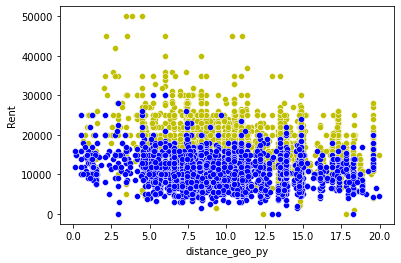

In [88]:
df_bhk=df[df['bhk']==2]
df_bhk=df_bhk[df_bhk['Area Sq.ft']<2000]
sns.scatterplot(data=df_bhk, x='distance_geo_py', y="Rent",color='y')
df_bhk=df[df['bhk']==1]
df_bhk=df_bhk[df_bhk['Area Sq.ft']<2000]
sns.scatterplot(data=df_bhk, x='distance_geo_py', y="Rent",color='b')

from on we are ploting the distibution of different parameters from the dataframe 

C:\Users\swaraj\AppData\Local\Programs\Python\Python39\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:ylabel='Density'>

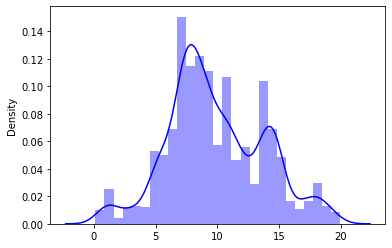

In [89]:
"""df_bhk=df[df['bhk']==2]
df_bhk=df_bhk[df_bhk['Area Sq.ft']>1000]
sns.distplot()(data=df_bhk, x='distance_geo_py',color='y')"""
df_bhk=df[df['bhk']==1]
df_bhk=df_bhk[df_bhk['Area Sq.ft']<2000]
sns.distplot( x=df_bhk['distance_geo_py'],color='b')

C:\Users\swaraj\AppData\Local\Programs\Python\Python39\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:ylabel='Density'>

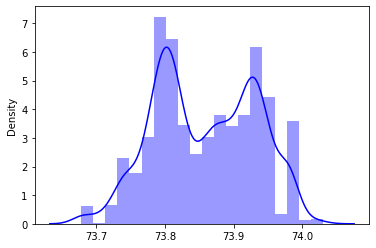

In [90]:
sns.distplot( x=df_bhk['longi'],color='b')

C:\Users\swaraj\AppData\Local\Programs\Python\Python39\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:ylabel='Density'>

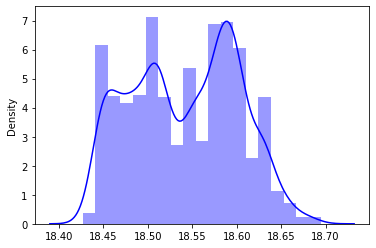

In [91]:
sns.distplot( x=df_bhk['lat'],color='b')

C:\Users\swaraj\AppData\Local\Programs\Python\Python39\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:ylabel='Density'>

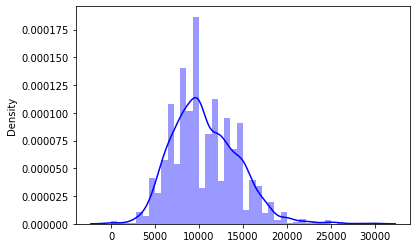

In [92]:
sns.distplot( x=df_bhk['Rent'],color='b')

C:\Users\swaraj\AppData\Local\Programs\Python\Python39\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:ylabel='Density'>

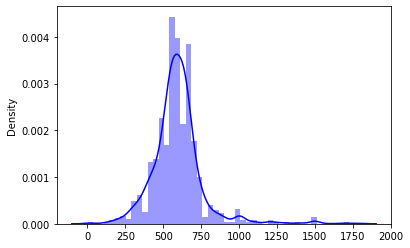

In [93]:
sns.distplot( x=df_bhk['Area Sq.ft'],color='b')

#seeing the distribution of rent and area

In [95]:
da=df[df['Area Sq.ft']<2000]

<AxesSubplot:xlabel='Area Sq.ft', ylabel='Rent'>

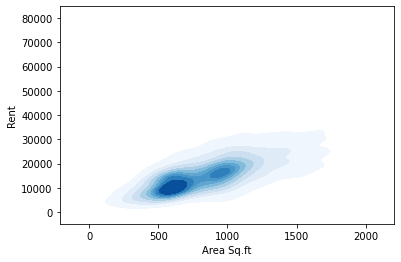

In [96]:
sns.kdeplot(x=da['Area Sq.ft'], y=da['Rent'], cmap="Blues", shade=True)

<AxesSubplot:xlabel='lat', ylabel='longi'>

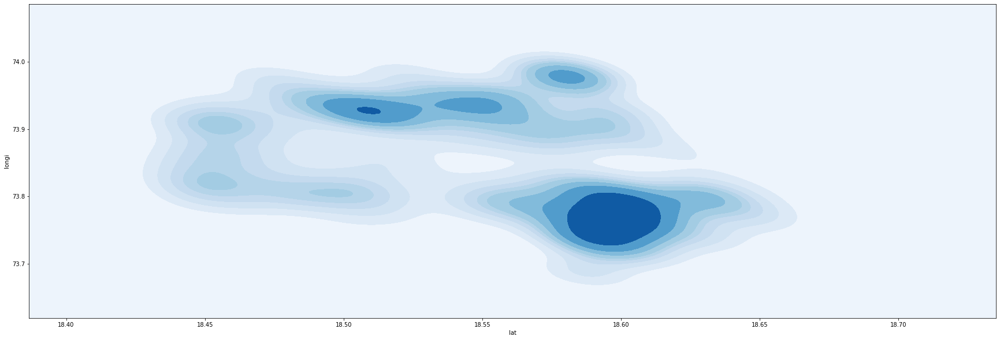

In [97]:
fig = plt.figure(figsize = (30, 10))
sns.kdeplot(x=df['lat'], y=df['longi'], cmap="Blues", shade=True, thresh=0)

<AxesSubplot:xlabel='lat', ylabel='longi'>

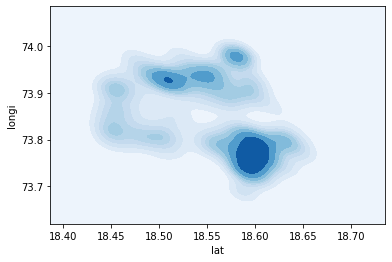

In [98]:
sns.kdeplot(x=df['lat'], y=df['longi'], cmap="Blues", shade=True, thresh=0)

<AxesSubplot:xlabel='distance_geo_py', ylabel='Rent'>

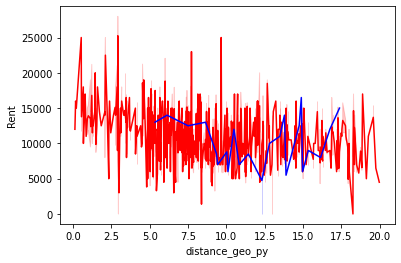

In [99]:
df_bhk=df[df['bhk']<2]
df_bhk=df_bhk[df_bhk['Area Sq.ft']<2000]
sns.lineplot(data=df_bhk, x='distance_geo_py', y="Rent",color='r')
df_bhk=df[df['bhk']==1]
df_bhk=df_bhk[df_bhk['Area Sq.ft']>2000]
sns.lineplot(data=df_bhk, x='distance_geo_py', y="Rent",color='b')

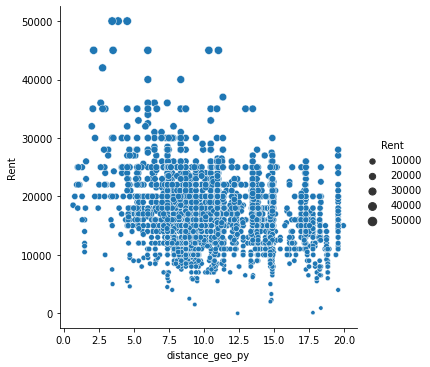

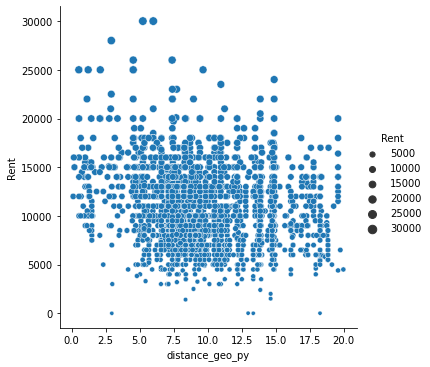

In [100]:

df_bhk=df[df['bhk']==2]
df_bhk=df_bhk[df_bhk['Area Sq.ft']<2000]
sns.relplot(data=df_bhk, x='distance_geo_py', y="Rent",size="Rent" ,palette="ch:r=-.5,l=.75")
df_bhk=df[df['bhk']==1]
df_bhk=df_bhk[df_bhk['Area Sq.ft']<2000]
sns.relplot(data=df_bhk, x='distance_geo_py', y="Rent",size="Rent", palette="ch:r=-.5,l=.75")

<ipython-input-101-080df6056851>:2: MatplotlibDeprecationWarning: Calling gca() with keyword arguments was deprecated in Matplotlib 3.4. Starting two minor releases later, gca() will take no keyword arguments. The gca() function should only be used to get the current axes, or if no axes exist, create new axes with default keyword arguments. To create a new axes with non-default arguments, use plt.axes() or plt.subplot().
  ax = fig.gca(projection='3d')


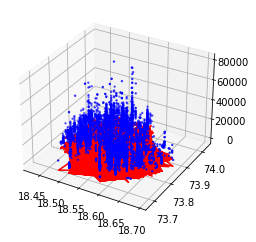

In [101]:
fig = plt.figure()
ax = fig.gca(projection='3d')

x = df['lat']
y = df['longi']
z = df['Rent']

ax.plot(x, y, zs= 0, zdir = 'z', c= 'r')

ax.scatter(x,y, z, c = 'b', s = 2)

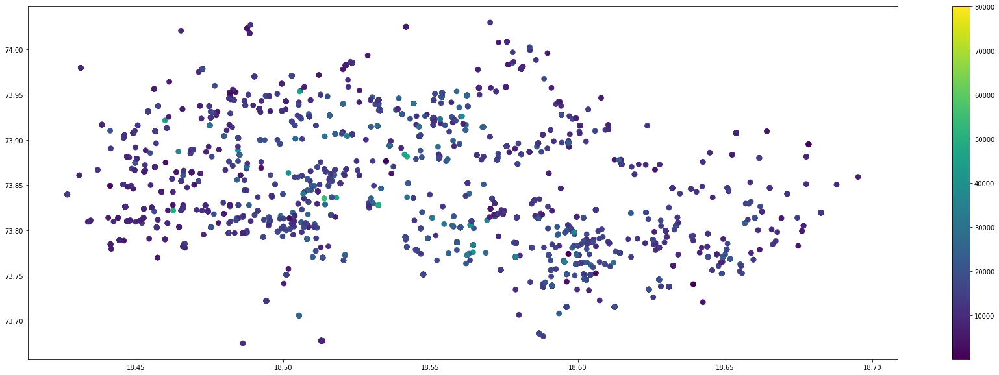

In [111]:
 fig = plt.figure(figsize = (30, 10))
 plt.scatter(x, y, c=z,s=60, cmap='viridis')
 plt.colorbar()

In [114]:
my_cmap = plt.get_cmap('hsv')

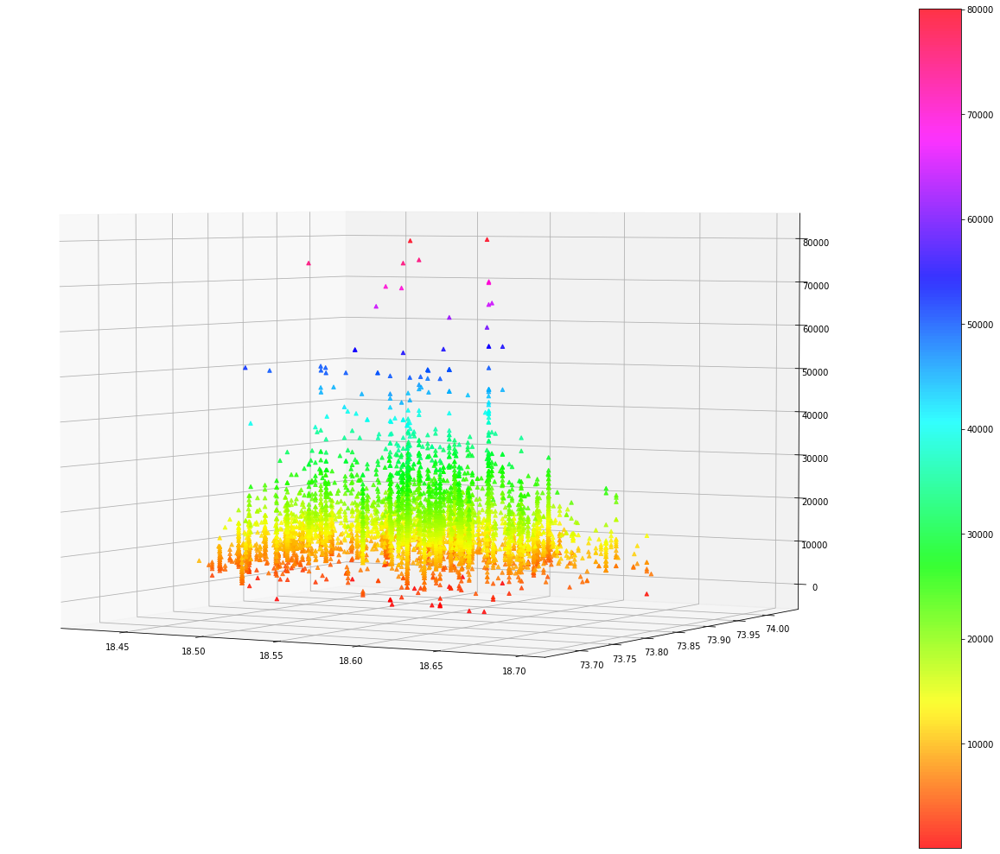

In [130]:
fig=plt.figure(figsize=(30,10))
x=df['lat']
y=df['longi']
z=df['Rent']
# Set the bottom and top outside the actual figure limits, 
# to stretch the 3D axis
fig.subplots_adjust(bottom=-0.15,top=1.2)

ax = fig.add_subplot(111, projection='3d')

# Change the viewing angle to an agreeable one
ax.view_init(3,None)

#ax = fig.axes(projection ="3d")
 
# Creating plot
sctt = ax.scatter3D(x, y, z,
                    alpha = 0.8,
                    c = (x+y+z),
                    cmap = my_cmap,
                    marker ='^')
fig.colorbar(sctt)

<ipython-input-136-9b590fb870b9>:22: MatplotlibDeprecationWarning: Starting from Matplotlib 3.6, colorbar() will steal space from the mappable's axes, rather than from the current axes, to place the colorbar.  To silence this warning, explicitly pass the 'ax' argument to colorbar().
  fig.colorbar(p)


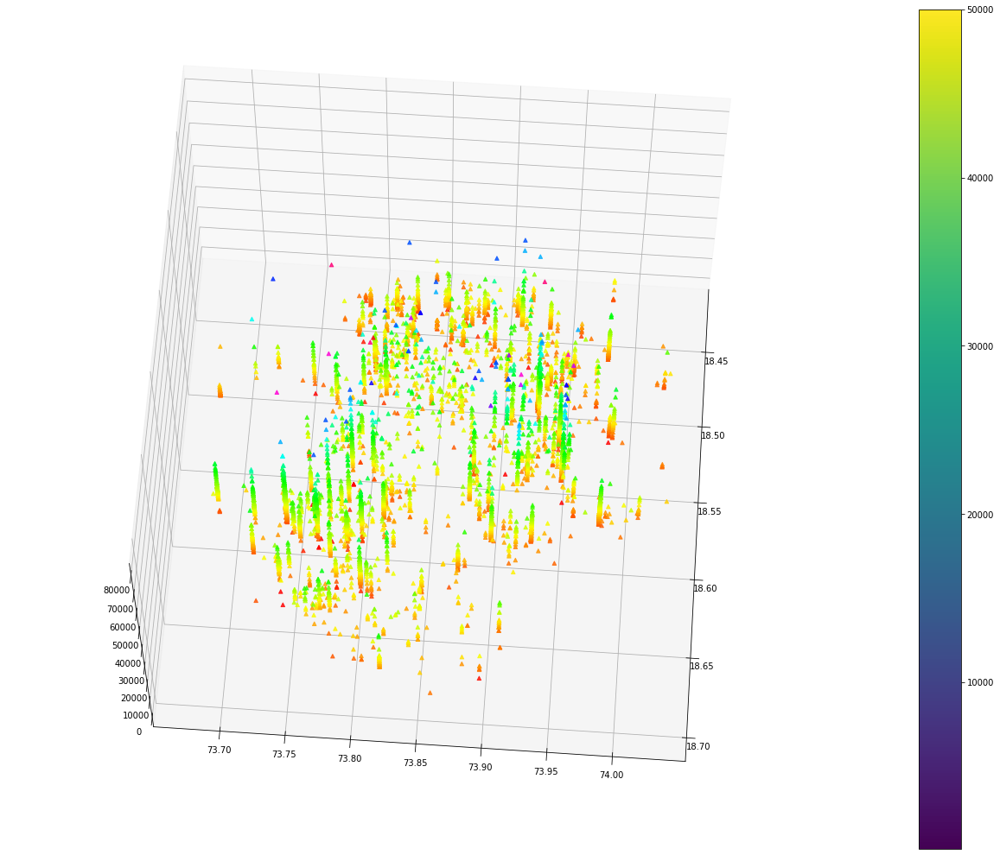

In [136]:
fig=plt.figure(figsize=(30,10))
x=df['lat']
y=df['longi']
z=df['Rent']
# Set the bottom and top outside the actual figure limits, 
# to stretch the 3D axis
fig.subplots_adjust(bottom=-0.15,top=1.2)

ax = fig.add_subplot(111, projection='3d')

# Change the viewing angle to an agreeable one
ax.view_init(64,4)

#ax = fig.axes(projection ="3d")
 
# Creating plot
sctt = ax.scatter3D(x, y, z,
                    alpha = 0.8,
                    c = (x+y+z),
                    cmap = my_cmap,
                    marker ='^')
fig.colorbar(p)

In [46]:
df.columns

Index(['Unnamed: 0', 'location', 'Area Sq.ft', 'bhk', 'bath_clean', 'dates',
       'Title_modify', 'lat', 'longi', 'Rent', 'distance_geo_py'],
      dtype='object')

#plotting of the data in 3d on the bases of lat longi area rent  and filetrong them on various bases 

<Figure size 432x288 with 0 Axes>

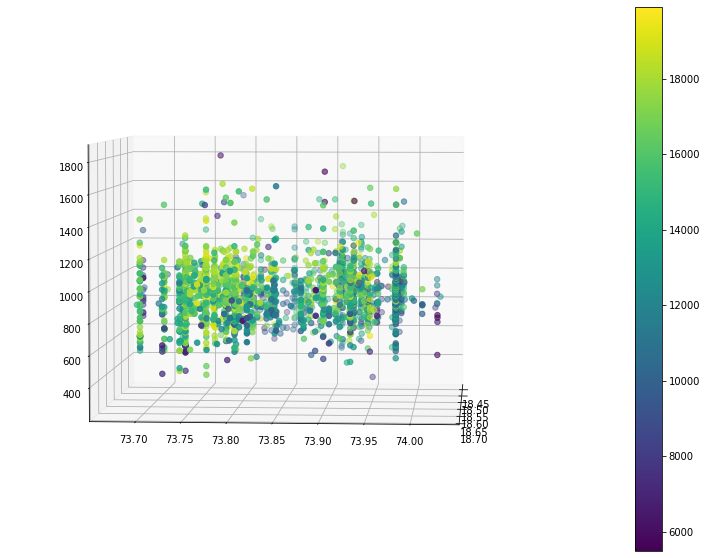

In [131]:
df_bhk=df[df['bhk']==2]
df_bhk=df_bhk[df_bhk['Area Sq.ft']<2000]
df_bhk=df_bhk[df_bhk['Rent']<20000]
df_bhk=df_bhk[df_bhk['Rent']>5000]
cm = plt.get_cmap("RdYlGn")
#fig = plt.figure(figsize = (30, 100))
fig = plt.figure()
x=df_bhk['lat']
y=df_bhk['longi']
z=df_bhk['Area Sq.ft']
c=df_bhk['Rent']
fig = plt.figure(figsize = (30, 10))
ax3D = fig.add_subplot(111, projection='3d')
ax3D.view_init(4,4)

p=ax3D.scatter(x, y, z, s=30, c=c, marker='o')

                      
plt.colorbar(p)
plt.show()


<Figure size 432x288 with 0 Axes>

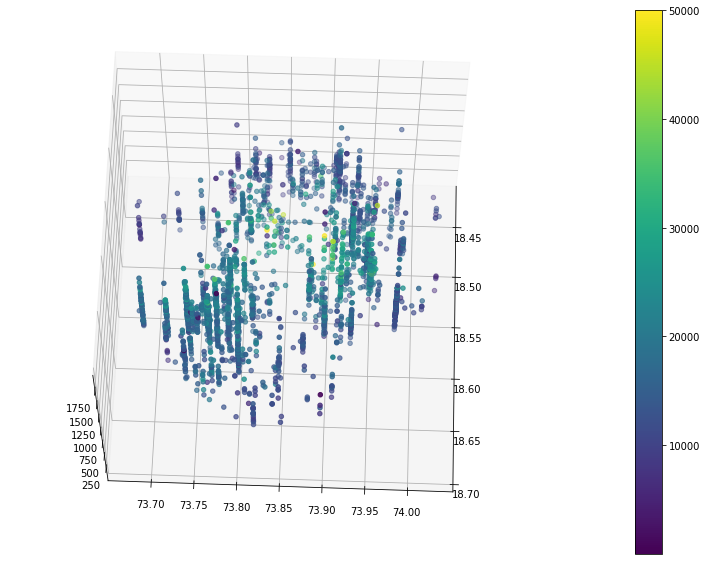

In [126]:
df_bhk=df[df['bhk']==2]
df_bhk=df_bhk[df_bhk['Area Sq.ft']<2000]
cm = plt.get_cmap("RdYlGn")
#fig = plt.figure(figsize = (30, 100))
fig = plt.figure()
x=df_bhk['lat']
y=df_bhk['longi']
z=df_bhk['Area Sq.ft']
c=df_bhk['Rent']
fig = plt.figure(figsize = (30, 10))
ax3D = fig.add_subplot(111, projection='3d')
ax3D.view_init(64,2)

p=ax3D.scatter(x, y, z, s=20, c=c, marker='o')

                      
plt.colorbar(p)
plt.show()

<Figure size 432x288 with 0 Axes>

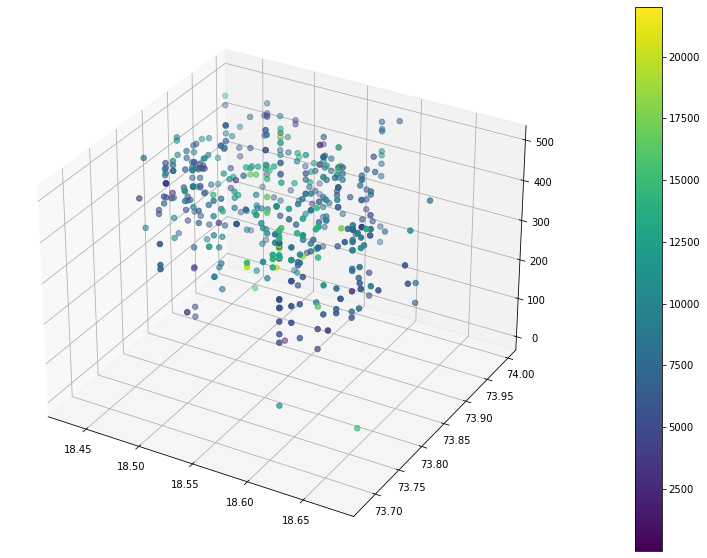

In [48]:
df_bhk=df[df['bath_clean']==1]
df_bhk=df_bhk[df_bhk['Area Sq.ft']<500]
cm = plt.get_cmap("RdYlGn")
#fig = plt.figure(figsize = (30, 100))
fig = plt.figure()
x=df_bhk['lat']
y=df_bhk['longi']
z=df_bhk['Area Sq.ft']
c=df_bhk['Rent']
fig = plt.figure(figsize = (30, 10))
ax3D = fig.add_subplot(111, projection='3d')

p=ax3D.scatter(x, y, z, s=30, c=c, marker='o')

                      
plt.colorbar(p)
plt.show()

In [49]:
df.columns

Index(['Unnamed: 0', 'location', 'Area Sq.ft', 'bhk', 'bath_clean', 'dates',
       'Title_modify', 'lat', 'longi', 'Rent', 'distance_geo_py'],
      dtype='object')

<Figure size 432x288 with 0 Axes>

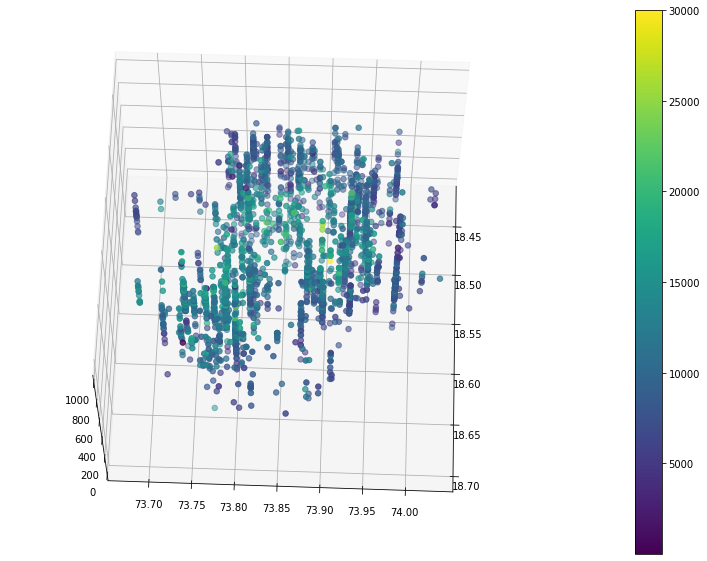

In [127]:
df_bhk=df[df['bhk']==1]# selecting the bhk values
df_bhk=df_bhk[df_bhk['Area Sq.ft']<1000]#selecting areas
cm = plt.get_cmap("RdYlGn")
#fig = plt.figure(figsize = (30, 100))
fig = plt.figure()
x=df_bhk['lat']#selecting x values
y=df_bhk['longi']#selecting 
z=df_bhk['Area Sq.ft']
c=df_bhk['Rent']
fig = plt.figure(figsize = (30, 10))#selecting figure size
ax3D = fig.add_subplot(111, projection='3d')

p=ax3D.scatter(x, y, z, s=30, c=c, marker='o')#plotting scatter plot in 3d

                      
plt.colorbar(p)
plt.show()


<Figure size 432x288 with 0 Axes>

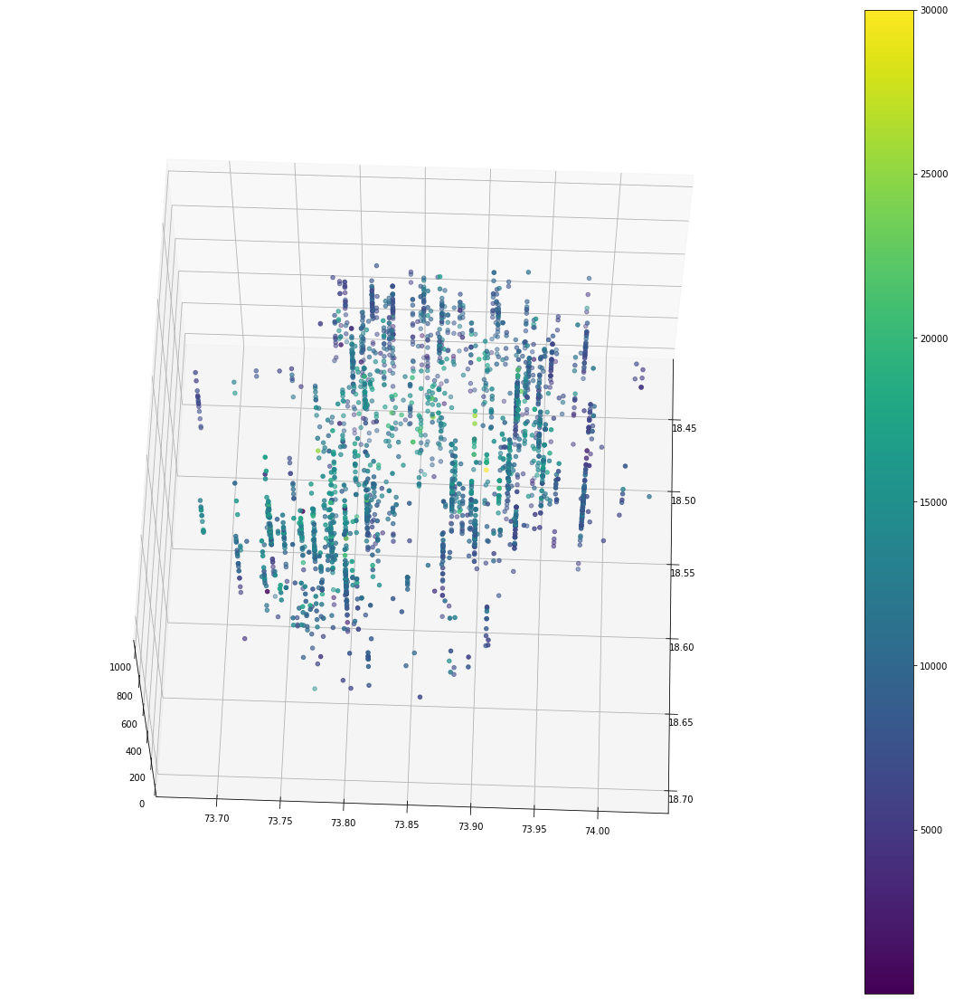

In [131]:
df_bhk=df[df['bhk']==1]# selecting the bhk values
df_bhk=df_bhk[df_bhk['Area Sq.ft']<1000]#selecting areas
cm = plt.get_cmap("RdYlGn")
#fig = plt.figure(figsize = (30, 100))
fig = plt.figure()
x=df_bhk['lat']#selecting x values
y=df_bhk['longi']#selecting 
z=df_bhk['Area Sq.ft']
c=df_bhk['Rent']
fig = plt.figure(figsize = (20, 20))#selecting figure size
ax3D = fig.add_subplot(111, projection='3d')
ax3D.view_init(64,2)
p=ax3D.scatter(x, y, z, s=20, c=c, marker='o')#plotting scatter plot in 3d

                      
plt.colorbar(p)
plt.show()

<Figure size 432x288 with 0 Axes>

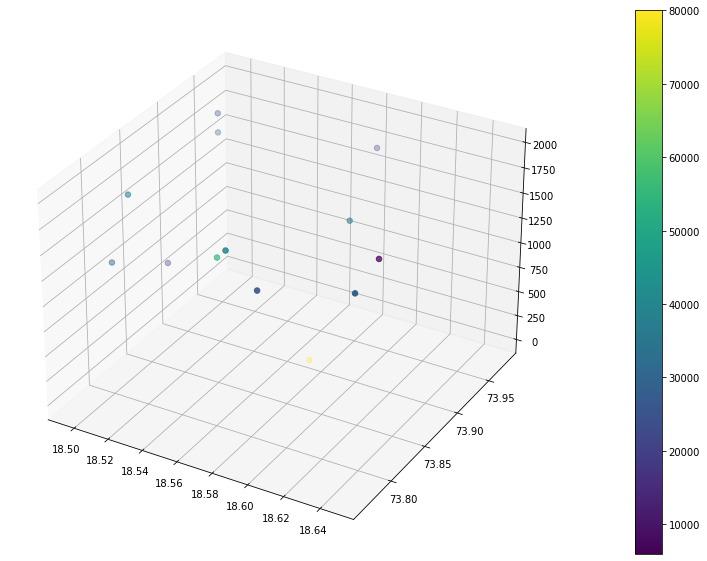

In [51]:
df_bhk=df[df['bhk']>3]# selecting the bhk values
df_bhk=df_bhk[df_bhk['Area Sq.ft']<2000]#selecting areas
cm = plt.get_cmap("RdYlGn")
#fig = plt.figure(figsize = (30, 100))
fig = plt.figure()
x=df_bhk['lat']#selecting x values
y=df_bhk['longi']#selecting 
z=df_bhk['Area Sq.ft']
c=df_bhk['Rent']
fig = plt.figure(figsize = (30, 10))#selecting figure size
ax3D = fig.add_subplot(111, projection='3d')

p=ax3D.scatter(x, y, z, s=30, c=c, marker='o')#plotting scatter plot in 3d

                      
plt.colorbar(p)
plt.show()

<Figure size 432x288 with 0 Axes>

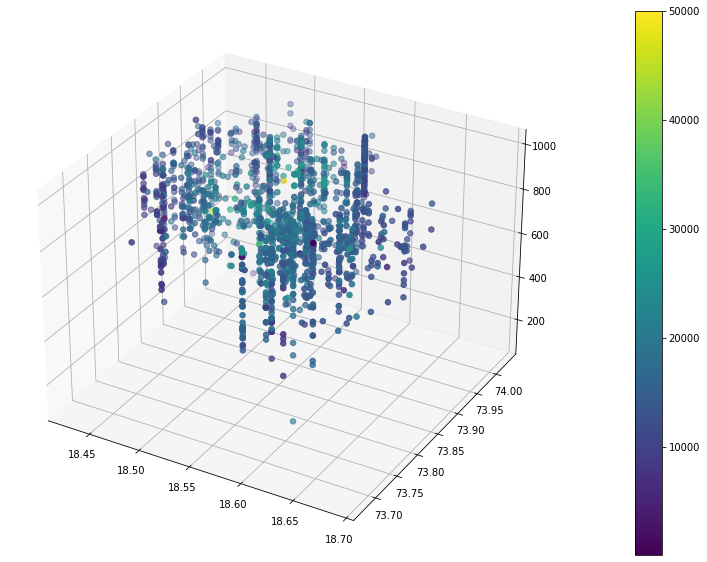

In [132]:
df_bhk=df[df['bhk']==2]# selecting the bhk values
df_bhk=df_bhk[df_bhk['Area Sq.ft']<1000]#selecting areas
cm = plt.get_cmap("RdYlGn")
#fig = plt.figure(figsize = (30, 100))
fig = plt.figure()
x=df_bhk['lat']#selecting x values
y=df_bhk['longi']#selecting 
z=df_bhk['Area Sq.ft']
c=df_bhk['Rent']
fig = plt.figure(figsize = (30, 10))#selecting figure size
ax3D = fig.add_subplot(111, projection='3d')

p=ax3D.scatter(x, y, z, s=30, c=c, marker='o')#plotting scatter plot in 3d

                      
plt.colorbar(p)
plt.show()

<Figure size 432x288 with 0 Axes>

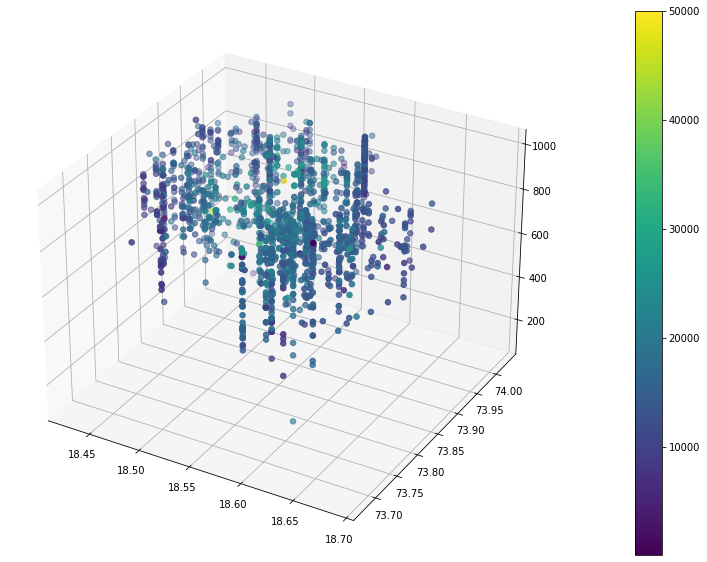

In [53]:
df_bhk=df[df['bhk']==2]# selecting the bhk values
df_bhk=df_bhk[df_bhk['Area Sq.ft']<1000]#selecting areas
cm = plt.get_cmap("RdYlGn")
#fig = plt.figure(figsize = (30, 100))
fig = plt.figure()
x=df_bhk['lat']#selecting x values
y=df_bhk['longi']#selecting 
z=df_bhk['Area Sq.ft']
c=df_bhk['Rent']
fig = plt.figure(figsize = (30, 10))#selecting figure size
ax3D = fig.add_subplot(111, projection='3d')

p=ax3D.scatter(x, y, z, s=30, c=c, marker='o')#plotting scatter plot in 3d

                      
plt.colorbar(p)
plt.show()

<Figure size 432x288 with 0 Axes>

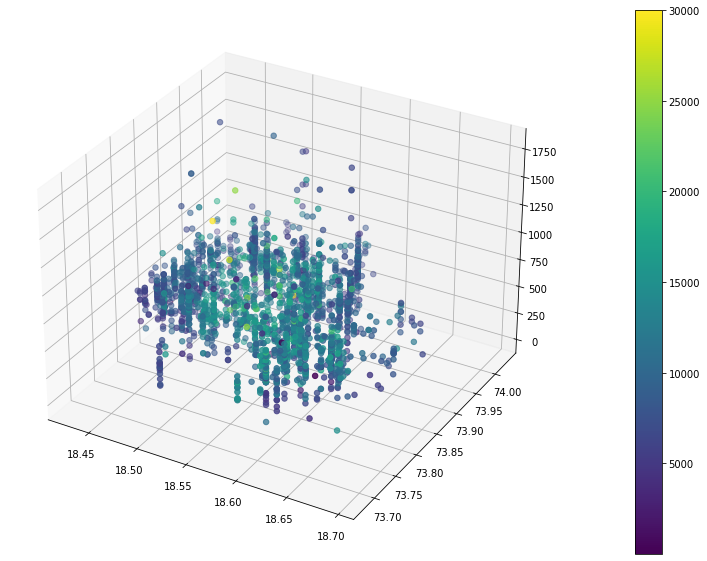

In [54]:
df_bhk=df[df['bhk']==1]# selecting the bhk values
df_bhk=df_bhk[df_bhk['Area Sq.ft']<2000]#selecting areas
cm = plt.get_cmap("RdYlGn")
#fig = plt.figure(figsize = (30, 100))
fig = plt.figure()
x=df_bhk['lat']#selecting x values
y=df_bhk['longi']#selecting 
z=df_bhk['Area Sq.ft']
c=df_bhk['Rent']
fig = plt.figure(figsize = (30, 10))#selecting figure size
ax3D = fig.add_subplot(111, projection='3d')

p=ax3D.scatter(x, y, z, s=30, c=c, marker='o')#plotting scatter plot in 3d

                      
plt.colorbar(p)
plt.show()

In [55]:
df_bhk.shape

(2672, 11)

In [136]:
from sklearn.model_selection import train_test_split
from sklearn.neighbors import KNeighborsClassifier
from sklearn.preprocessing import MinMaxScaler

In [137]:

from sklearn.neighbors import KNeighborsRegressor

In [143]:
df.columns


Index(['Unnamed: 0', 'location', 'Area Sq.ft', 'bhk', 'bath_clean', 'dates',
       'Title_modify', 'lat', 'longi', 'Rent', 'geometry', 'distance_geo_py'],
      dtype='object')

In [146]:
x=df[['Area Sq.ft', 'bhk', 'bath_clean', 'lat', 'longi', 'distance_geo_py']]

In [147]:
x

,Area Sq.ft,bhk,bath_clean,lat,longi,distance_geo_py
0,950,1,1,18.573820,73.756159,12.313004
1,600,1,0,18.517725,73.906705,5.328281
2,667,1,1,18.594470,73.927589,11.435070
3,735,1,0,18.474525,73.820954,5.976328
4,1200,1,1,18.450386,73.879375,7.738232
...,...,...,...,...,...,...
7077,1011,1,1,18.591272,73.738909,14.884507
7078,650,0,0,18.489072,73.810293,5.738218
7079,583,0,1,18.579023,73.785991,10.127872
7080,570,1,1,18.494298,73.722042,14.388547


In [141]:

y=df['Rent']


In [148]:
from sklearn import preprocessing 
  
# label_encoder object knows how to understand word labels. 
label_encoder = preprocessing.LabelEncoder() 
  
# Encode labels in column 'species'. 
df['bhk']= label_encoder.fit_transform(df['bhk'])
df['bath_clean']= label_encoder.fit_transform(df['bath_clean'])
scaler = MinMaxScaler()
x[['Area Sq.ft','lat','longi','distance_geo_py']] = scaler.fit_transform(df[['Area Sq.ft','lat','longi','distance_geo_py']])
x[['bhk','bath_clean']]=df[['bhk','bath_clean']]
y=df['Rent']

<ipython-input-148-9ff0bdaa95e5>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['bhk']= label_encoder.fit_transform(df['bhk'])
<ipython-input-148-9ff0bdaa95e5>:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['bath_clean']= label_encoder.fit_transform(df['bath_clean'])
<ipython-input-148-9ff0bdaa95e5>:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pa

In [149]:
x

,Area Sq.ft,bhk,bath_clean,lat,longi,distance_geo_py
0,0.000027,1,1,0.547921,0.228473,0.614277
1,0.000017,1,0,0.338792,0.652949,0.262377
2,0.000019,1,1,0.624908,0.711832,0.570045
3,0.000021,1,0,0.177741,0.411165,0.295026
4,0.000034,1,1,0.087747,0.575888,0.383793
...,...,...,...,...,...,...
7077,0.000028,1,1,0.612983,0.179834,0.743833
7078,0.000018,0,0,0.231973,0.381106,0.283030
7079,0.000016,0,1,0.567319,0.312586,0.504187
7080,0.000016,1,1,0.251457,0.132276,0.718846


In [150]:
y

0       15000
1       12000
2       16000
3       11000
4       18000
        ...  
7077    23000
7078    10000
7079    14000
7080    12500
7081    20000
Name: Rent, Length: 6683, dtype: int64

In [151]:
x_train, x_test, y_train, y_test = train_test_split(x, y, random_state=42)

In [152]:
knn = KNeighborsRegressor(n_neighbors=5)
knn.fit(x_train,y_train)

KNeighborsRegressor()

Text(0, 0.5, 'Error Rate')

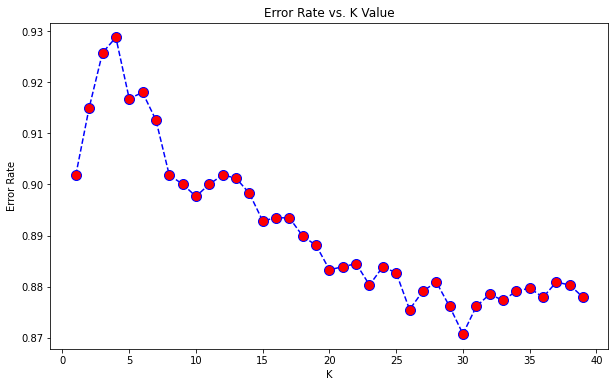

In [153]:
error_rate = []
# Might take some time
for i in range(1,40):
    
    knn = KNeighborsClassifier(n_neighbors=i)
    knn.fit(x_train,y_train)
    pred_i = knn.predict(x_test)
    error_rate.append(np.mean(pred_i != y_test))
plt.figure(figsize=(10,6))
plt.plot(range(1,40),error_rate,color='blue', linestyle='dashed', marker='o',
         markerfacecolor='red', markersize=10)
plt.title('Error Rate vs. K Value')
plt.xlabel('K')
plt.ylabel('Error Rate')

C:\Users\swaraj\AppData\Local\Programs\Python\Python39\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
Mean Absolute Error: 3059.1621783363257
Mean Squared Error: 22948937.155409545
Root Mean Squared Error: 4790.504895667005


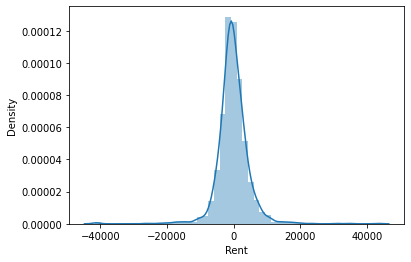

In [156]:
knn = KNeighborsRegressor(n_neighbors=26)
knn.fit(x_train,y_train)
pred = knn.predict(x_test)
sns.distplot(y_test-pred)
from sklearn import metrics
print('Mean Absolute Error:', metrics.mean_absolute_error(y_test, pred))
print('Mean Squared Error:', metrics.mean_squared_error(y_test, pred))
print('Root Mean Squared Error:', np.sqrt(metrics.mean_squared_error(y_test, pred)))

C:\Users\swaraj\AppData\Local\Programs\Python\Python39\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


(0.0, 1.0)

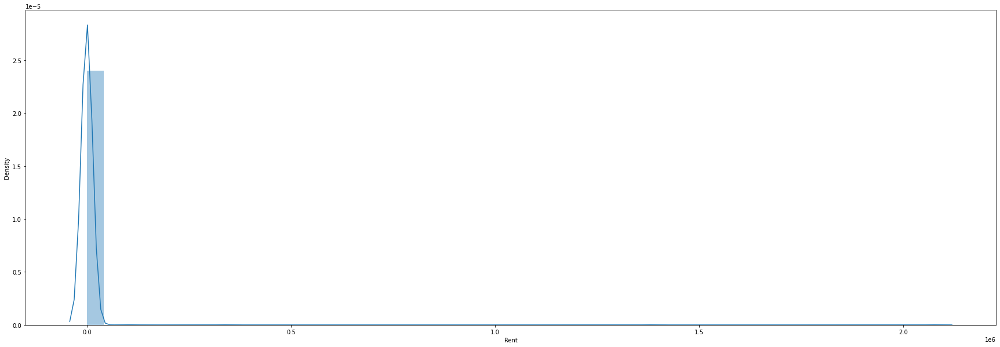

In [171]:
fig = plt.figure(figsize = (30, 10))
sns.distplot(((-y_test+pred)/y_test)*100)
ax.set_xlim(0, 1)

In [162]:
from sklearn.model_selection import GridSearchCV
parameters = {
   "n_neighbors": range(1, 50),
    "weights": ["uniform", "distance"],
 }
gridsearch = GridSearchCV(KNeighborsRegressor(), parameters,scoring='neg_mean_squared_error',  cv =10 , verbose=2,  n_jobs = -1)

gridsearch.fit(x_train, y_train)
gridsearch.fit(x_train,y_train)
gridsearch.best_params_
gridsearch.best_score_


Fitting 10 folds for each of 98 candidates, totalling 980 fits
Fitting 10 folds for each of 98 candidates, totalling 980 fits


-22253747.296742372

C:\Users\swaraj\AppData\Local\Programs\Python\Python39\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
Mean Absolute Error: 2953.3543703277746
Mean Squared Error: 20693010.808842085
Root Mean Squared Error: 4548.957112222766


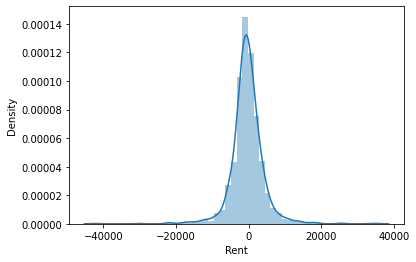

In [218]:
prediction=gridsearch.predict(x_test)
sns.distplot(y_test-prediction)

print('Mean Absolute Error:', metrics.mean_absolute_error(y_test, prediction))
print('Mean Squared Error:', metrics.mean_squared_error(y_test, prediction))
print('Root Mean Squared Error:', np.sqrt(metrics.mean_squared_error(y_test, prediction)))

C:\Users\swaraj\AppData\Local\Programs\Python\Python39\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='Rent', ylabel='Density'>

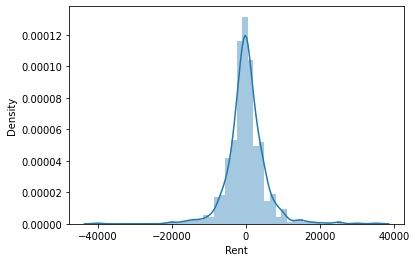

In [163]:
from sklearn import metrics
print('Mean Absolute Error:', metrics.mean_absolute_error(y_test, pred))
print('Mean Squared Error:', metrics.mean_squared_error(y_test, pred))
print('Root Mean Squared Error:', np.sqrt(metrics.mean_squared_error(y_test, pred)))

Mean Absolute Error: 3059.1621783363257
Mean Squared Error: 22948937.155409545
Root Mean Squared Error: 4790.504895667005


In [164]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import RandomizedSearchCV
regressor=RandomForestRegressor()
n_estimators = [int(x) for x in np.linspace(start = 50, stop = 1200, num = 120)]
print(n_estimators)
# Number of features to consider at every split
max_features = ['auto', 'sqrt']
# Maximum number of levels in tree
max_depth = [int(x) for x in np.linspace(5, 30, num = 12)]
# max_depth.append(None)
# Minimum number of samples required to split a node
min_samples_split = [2, 5, 10, 15, 100]
# Minimum number of samples required at each leaf node
min_samples_leaf = [1, 2, 5, 10,8,7,9,15,20]
random_grid = {'n_estimators': n_estimators,
               'max_features': max_features,
               'max_depth': max_depth,
               'min_samples_split': min_samples_split,
               'min_samples_leaf': min_samples_leaf}

print(random_grid)
rf = RandomForestRegressor()
rf_random = RandomizedSearchCV(estimator = rf, param_distributions = random_grid,scoring='neg_mean_squared_error', n_iter = 15, cv =10 , verbose=2, random_state=42, n_jobs = -1)
rf_random.fit(x_train,y_train)
rf_random.best_params_
rf_random.best_score_


[50, 59, 69, 78, 88, 98, 107, 117, 127, 136, 146, 156, 165, 175, 185, 194, 204, 214, 223, 233, 243, 252, 262, 272, 281, 291, 301, 310, 320, 330, 339, 349, 359, 368, 378, 388, 397, 407, 417, 426, 436, 446, 455, 465, 475, 484, 494, 504, 513, 523, 533, 542, 552, 562, 571, 581, 591, 600, 610, 620, 629, 639, 649, 658, 668, 678, 687, 697, 707, 716, 726, 736, 745, 755, 765, 774, 784, 794, 803, 813, 823, 832, 842, 852, 861, 871, 881, 890, 900, 910, 919, 929, 939, 948, 958, 968, 977, 987, 997, 1006, 1016, 1026, 1035, 1045, 1055, 1064, 1074, 1084, 1093, 1103, 1113, 1122, 1132, 1142, 1151, 1161, 1171, 1180, 1190, 1200]
{'n_estimators': [50, 59, 69, 78, 88, 98, 107, 117, 127, 136, 146, 156, 165, 175, 185, 194, 204, 214, 223, 233, 243, 252, 262, 272, 281, 291, 301, 310, 320, 330, 339, 349, 359, 368, 378, 388, 397, 407, 417, 426, 436, 446, 455, 465, 475, 484, 494, 504, 513, 523, 533, 542, 552, 562, 571, 581, 591, 600, 610, 620, 629, 639, 649, 658, 668, 678, 687, 697, 707, 716, 726, 736, 745, 755, 76

-20212907.215516932

In [165]:
prediction=rf_random.predict(x_test)

C:\Users\swaraj\AppData\Local\Programs\Python\Python39\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
Mean Absolute Error: 2788.6185404510643
Mean Squared Error: 19305000.327075075
Root Mean Squared Error: 4393.745591983573


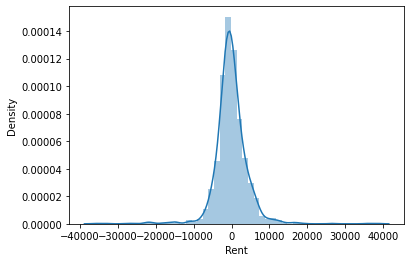

In [166]:
rf_new=rf_random.best_estimator_
prediction=rf_new.predict(x_test)
sns.distplot(y_test-prediction)
from sklearn import metrics
print('Mean Absolute Error:', metrics.mean_absolute_error(y_test, prediction))
print('Mean Squared Error:', metrics.mean_squared_error(y_test, prediction))
print('Root Mean Squared Error:', np.sqrt(metrics.mean_squared_error(y_test, prediction)))

C:\Users\swaraj\AppData\Local\Programs\Python\Python39\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='Rent', ylabel='Density'>

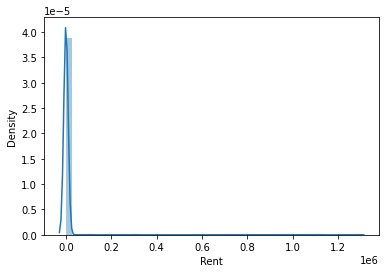

In [173]:
sns.distplot(((-y_test+prediction)/y_test)*100)
ax.set_xlim(0, 0.1)

In [232]:
x_test

,bhk,bath_clean,Area Sq.ft,lat,longi,distance_geo_py
5584,0,0,0.000016,0.335320,0.597614,0.060087
2910,1,1,0.000021,0.443774,0.576824,0.065576
2177,0,0,0.000017,0.470864,0.502281,0.122530
38,1,1,0.000023,0.335320,0.597614,0.060087
2107,0,0,0.000021,0.341251,0.465979,0.154353
...,...,...,...,...,...,...
4728,1,1,0.000030,0.245561,0.536193,0.074137
1778,2,2,0.000037,0.473817,0.504768,0.120608
6065,2,2,0.000047,0.408052,0.523752,0.070781
6733,0,0,0.000014,0.505931,0.519237,0.119975


In [ ]:
prediction=rf_random.predict(x_test)

In [222]:
from sklearn.preprocessing import StandardScaler